# Import libraries

In [2]:
import numpy as np
import matplotlib.pyplot as plt
import scipy
from scipy import stats
from scipy.stats import norm
from scipy.stats import expon
import scipy.optimize as opt
import os
import glob
import pandas as pd
import arviz as az
import pymc3 as pm
from datetime import datetime, timedelta
from scipy.special import expit as logistic
plt.rcParams.update({'font.size': 16})
import warnings
warnings.filterwarnings("ignore")

# Define functions

In [3]:
def CI_95(data):
    """
    Definition: Calcualtes the 95% confidence interval for any dataset
    
    Inputs:
    data = array of data 
    
    Outputs:
    ci_hi = 95% CI ceiling 
    ci_lo = 95% CI floor 
    """
    
    z = 1.96
    data_mu = np.mean(data)
    n = len(data)
    df = n-1
    s = np.sqrt(np.sum((data - data_mu)**2) / df)
        
    ci_hi = data_mu + z * (s/np.sqrt(n))
    ci_lo = data_mu - z * (s/np.sqrt(n))
    
    return ci_hi, ci_lo

In [4]:
def UniqueVals(stims, responses):
    
    """
    Definition: Takes stimulus values and responses and calculates N (total number of trials) and K (number of responses of interest) 
    for each unique stimulus values
    
    Inputs:
    stims = vector of all stimuli
    responses = vector of all responses
    
    Outputs:
    unique_stims = vector of the unrepeated stimulus locations
    Nstims = the number of times each unique stim was visited (vector)
    Kleft = the number of times the response was left at each stim location
    """
    
    unique_stims, stim_idx = np.unique(stims, return_index=True)
    Nstims, Kleft = [], []
    for u in unique_stims:
        stim_idx = np.argwhere(u==stims)
        Nstims = np.append(Nstims,len(stim_idx))
        Kleft = np.append(Kleft, np.sum(responses[stim_idx]))
        
    return unique_stims, Nstims, Kleft

In [5]:
def nloglik(params, X, N, K):
    
    """
    Definition: This function returns the negative log likelihood of the parameters mu and sigma 
    for a data set
    
    Inputs:
    params = parameter values, in this case, an array of size 2 with parameters alpha and beta
    X = stimuli (vector)
    N = number of trials at each X 
    K = Number of trials with the response of interest
    
    Outputs:
    nll = the negative log likelihood 
    """ 
    
    alpha=params[0]
    beta=params[1]
    
    psi = norm.cdf(X,alpha,beta)       
    ll = np.sum(K * np.log(psi) + ((N - K) * np.log(1-psi)))

    nll = -ll
    
    return nll

In [6]:
def psiBIC(params, data):
    
    """
    Definition: calculates the bayesian information criteria (BIC) for a psychometric function 
    
    Inputs:
    params = vector of the parameters for the psychometric function (alpha, beta), in this case, it only takes two arguments
    data = a list of size 3 containing 
        1) N = the number of trials at each stimulus location
        2) K = the number of 'left' responses at each stimulus location
        3) x = the stimulus locations
    
    Outputs:
    BIC
    """   
    #Organize the data
    alpha = params[0]
    beta = params[1]
    N = data[0]
    K = data[1]
    x = data[2]
    
    #Calcualte the log likelihood    
    psi = norm.cdf(x,alpha,beta)
    ll = np.nansum(K * np.log(psi) + ((N - K) * np.log(1-psi)))
    
    #Calculate BIC
    BIC = -2 * ll + np.log(len(N)) * len(params)
    
    return BIC

In [7]:
def psiAIC(params, data):
    
    """
    Definition: calculates the Akaike information criteria (AIC) for a psychometric function 
    
    Inputs:
    params = vector of the parameters for the psychometric function (alpha, beta), in this case, it only takes two arguments
    data = a list of size 3 containing 
        1) N = the number of trials at each stimulus location
        2) K = the number of 'left' responses at each stimulus location
        3) x = the stimulus locations
    
    Outputs:
    AIC
    """   
    
    #Organize the data
    alpha = params[0]
    beta = params[1]
    N = data[0]
    K = data[1]
    x = data[2]
    
    #Calcualte the log likelihood    
    psi = norm.cdf(x,alpha,beta)
    ll = np.nansum(K * np.log(psi) + ((N - K) * np.log(1-psi)))

    #Calculate AIC
    AIC = 2*len(params) - 2*ll
    
    return AIC

In [8]:
def Fit_psi(stims, responses, Num_Inits):
    
    """
    Definition: Uses MLE to fit a psychometric function (normcdf) to data
    
    Inputs:
    stims = vector of all stimulus values 
    responses = vector of all responses
    Num_Inits = number of initializations
    
    Outputs:
    best_params = best paramers (size 2 vector)
    best_ll = log likelihood of the best parameters
    """   
    
    #Calculate unique values of the stims
    unique_stims, Nstims, Kleft = UniqueVals(stims, responses)

    temp_ll = []
    temp_params = np.empty((Num_Inits,2))
    for i in range(Num_Inits):
        # x0 = [np.random.randint(-30, 30), np.random.randint(0, 30)]
        x0 = [norm.rvs(0,20), expon.rvs(0,20)]
        
        res = opt.minimize(nloglik, x0=x0, args=(unique_stims,Nstims,Kleft),
                method='Nelder-Mead', bounds=((-50,50),(0,50)), options={'disp': False})
        
        temp_ll = np.append(temp_ll, res.fun)
        temp_params[i,:] = res.x

    min_idx = np.nanargmin(temp_ll)
    best_params = temp_params[min_idx]
    best_ll = temp_ll[min_idx]
    
    return best_params, best_ll

In [9]:
def MLE_each_trial(All_stims, All_responses):
    
    """
    Definition: Finds the max likelihood for each trial 
    
    inputs:
    stims = vector of all stimulus values 
    responses = vector of all responses
    
    outputs:
    MLE_alpha = vector of the max likelihood estimate for alpha on each trial
    MLE_beta = vector of the max likelihood estimate for beta on each trial 
    """
    
    #Set the alpha and beta ranges
    a_range = np.linspace(-100,100,201)
    b_range = np.linspace(0.001,100,201)
    
    MLE_alpha, MLE_beta, stims, responses = [], [], [], []
    #Loop through each trial
    for i in range(len(All_stims)):
        
        #Record the stim and response
        stims = np.append(stims, All_stims[i])
        responses = np.append(responses, All_responses[i])
        
        #Account for repeated stimuli 
        Unique_stims, Nstims, Kleft = UniqueVals(stims, responses)
        
        #Calcualte the likelihood for the response given the current parameters
        Likelihood = np.empty((len(b_range),len(a_range)))
        for a_idx, a in enumerate(a_range):
            for b_idx, b in enumerate(b_range):
                psi = norm.cdf(Unique_stims,a,b)
                Likelihood[b_idx,a_idx] = np.prod((psi**Kleft) * ((1-psi)**(Nstims-Kleft)))

        #Index the max likelihood for each
        lik_max_idx = np.unravel_index(Likelihood.argmax(), Likelihood.shape)
        MLE_alpha = np.append(MLE_alpha, a_range[lik_max_idx[1]])
        MLE_beta = np.append(MLE_beta, b_range[lik_max_idx[0]])

    return MLE_alpha, MLE_beta

In [10]:
#Look up table
def Psi_lookT(X, a_range, b_range):
    
    """
    Definiton: This function creates two lookup tables required for the psi algorithm to run more efficiently
    It is a table of probabilities for both responses (left and right in this case) given all possible
    alpha and beta values and all possible stimulus locations:
    p(r='left'|alpha,beta,X)
    p(r='right'|alpha,beta,X)
    
    Inputs:
    X = vector of all stimulus values 
    a_range = vector of all possible alpha values
    b_range = vector of all possible beta values (a_range and b_range must be the same size)
    
    Outputs:
    p_left_look = look up table for left (size = len(b_range), len(a_range), len(X))
    p_right_look =  look up table for right (size = len(b_range), len(a_range), len(X))
    """
        
    #Preallocate the lookup tables
    p_left_look = np.empty([len(b_range),len(a_range),(len(X))])
    p_right_look = np.empty([len(b_range),len(a_range),(len(X))])
    
    #Loop through all possible stimulus, alpha and beta values
    for x_i, x in enumerate(X):
        for a_i, a in enumerate(a_range):
            for b_i, b in enumerate(b_range):
                psi = norm.cdf(x,a,b)
                p_left_look[b_i,a_i,x_i] = psi
                p_right_look[b_i,a_i,x_i] = 1-psi

    return p_left_look, p_right_look

In [11]:
#Entropy
def CalcH(X, p_left_look, p_right_look, Prior):
    
    """
    Definition: Calculates the expected entropy (EH) of each possible stimulus value to determine which one minimizes,
    the entropy for the next trial. This is the stimulus that will provide the most information for both parameters
    
    Inputs:
    X = vector of all stimulus values 
    p_left_look = look up table for left (size = len(b_range), len(a_range), len(X))
    p_right_look =  look up table for right (size = len(b_range), len(a_range), len(X))
    Prior = 2d prior for the parameter estiamtes (alpha and beta)
    
    Outputs:
    EH = the expected entropy function, a vector of expected entropy values for each stimulus position (X)
    best_X = the best stimulus position, the one that minimizes entropy
    """
    
    #Simulate through each possible stim value, X
    EH = []
    for i, x in enumerate(X):

        #Calculate the probability of getting a response, r, after presenting test x at the next trial (across all possible parameter values)
        p_left = np.nansum(np.nansum(np.multiply(p_left_look[:,:,i],Prior)))
        p_right = np.nansum(np.nansum(np.multiply(p_right_look[:,:,i],Prior)))

        #Calculate the posterior for each response 
        Post_left = p_left_look[:,:,i]*Prior
        Post_left = Post_left / p_left
        Post_right = p_right_look[:,:,i]*Prior
        Post_right = Post_right / p_right

        #Estimate the entropy of the posterior distribution for each response
        H_left = -np.nansum(np.nansum(Post_left * np.log2(Post_left)))
        H_right = -np.nansum(np.nansum(Post_right * np.log2(Post_right)))
        
        #Combine the entropy calculations, weighted by their probabilities
        Total_H = (H_left*p_left) + (H_right*p_right)
        EH = np.append(EH, Total_H)
        
    best_X = X[np.argmin(EH)]
    return EH, best_X

In [12]:
def sim_psi(params, Ntrials, X, a_range, b_range, p_left_look, p_right_look, Prior):
    
    """
    Definition: Simulates the Psi method using the given parameters
    
    Inputs:
    params = vector of the parameters for the psychometric function (alpha, beta), in this case, it only takes two arguments
    Ntrials = number of trials to simulate
    X = vector of all stimulus values 
    a_range = vector of all possible alpha values
    b_range = vector of all possible beta values (a_range and b_range must be the same size)    
    p_left_look = look up table for left (size = len(b_range), len(a_range), len(X))
    p_right_look =  look up table for right (size = len(b_range), len(a_range), len(X))
    Prior = 2d prior for the parameter estiamtes (alpha and beta)
    
    Outputs:
    stims = vector of length Ntrials of all stimulus positions 
    responses = vector of length Ntrials of all simulated responses 
    alpha_EV = vector of length Ntrials of the alpha estimates after each trial
    beta_EV = vector of length Ntrials of the beta estimates after each trial
    """
    
    alpha = params[0]
    beta = params[1]
    
    stims, responses, alpha_EV, beta_EV = [], [], [], []
    for i in range(Ntrials):
        
        #Calculate the best stim position
        _, best_X = CalcH(X, p_left_look, p_right_look, Prior)
        stims = np.append(stims, best_X)
        
        #Simualte a response based on the parameters
        responses = np.append(responses, norm.cdf(best_X, alpha, beta) > np.random.rand())
        
        #Alt posterior calc
        stim_idx = np.argwhere(stims[i]==X)[0][0]
        if responses[i]==1:
            Posterior = p_left_look[:,:,stim_idx]*Prior
        elif responses[i]==0:
            Posterior = p_right_look[:,:,stim_idx]*Prior
        Posterior = Posterior/np.nansum(np.nansum(Posterior))
        
        #Marginalize the posterior
        alpha_post = np.nansum(Posterior,axis=0)
        beta_post = np.nansum(Posterior,axis=1)
        
        #Calculate the expected value of each
        alpha_EV = np.append(alpha_EV, np.nansum(a_range*alpha_post))
        beta_EV = np.append(beta_EV, np.nansum(b_range*beta_post))
        
        #The posterior becomes the prior for the next trial
        Prior = Posterior        
        
    return stims, responses, alpha_EV, beta_EV

In [13]:
def check_posterior(test, plt_entropy):
    
    """
    Definition: Probes each trial of the psi method with a focus on both simulus selection and parameter estimation. 
    returns a plot of the simulated posteriors used to caluclate entropy (if desired) and the likelihood and 
    posterior after each trial. 
    
    Inputs:
    test = a data frame for a single subject
    plt_entropy = boolean of whether or not to plot the simulated posteriors used to caluclate entropy
    
    Outputs:
    no variable, returns the plots described above
    """
       
    #Index the participant info
    SID = test.SID[0] + test.Test[0]
    BslDiff = round(test.BslDiff.values[0])    
    a_est = test.Alpha_EV.values + BslDiff
    b_est = test.Beta_EV.values
    Responses = test.BinaryResponses.values
    Stims = test.AllStims.values + BslDiff
    response_str = test.AllResponses.values
    trials = test.Trial_num.values
    selected_stims = test.SelectedStims.values
   
    X = np.arange(-100,110,10)
    a_range = np.linspace(-100,100,201) 
    b_range = np.linspace(0.001,100,201)
    p_left_look, p_right_look = Psi_lookT(X, a_range, b_range)

    #Set the priors
    p_alpha = norm.pdf(a_range,0, 20)
    p_beta = expon.pdf(b_range,0,20)
    p_alpha = np.reshape(p_alpha,(1,len(p_alpha)))
    p_beta = np.reshape(p_beta,(1,len(p_beta)))
    Prior = p_beta.T @ p_alpha
    
    fig, ax = plt.subplots(figsize=(15,7),tight_layout=True)    
    ax.plot(trials, Stims,'b',alpha=0.5)
    ax.plot(trials[(selected_stims==0) & (Responses==1)], Stims[(selected_stims==0) & (Responses==1)],'bo', markersize=7, label='Response = Left')
    ax.plot(trials[(selected_stims==0) & (Responses==0)], Stims[(selected_stims==0) & (Responses==0)],'bo',fillstyle='none', markersize=7, label='Response = Right')
    ax.plot(trials[(selected_stims==1) & (Responses==1)], Stims[(selected_stims==1) & (Responses==1)],'co', markersize=7, label='Pre-selected Stims')
    ax.plot(trials[(selected_stims==1) & (Responses==0)], Stims[(selected_stims==1) & (Responses==0)],'co',fillstyle='none', markersize=7)
    ax.plot(trials,np.zeros(len(test)),'k')
    ax.plot(trials,a_est,'b-',label='Alpha estimate')
    ax.plot(trials,b_est,'r-',label='Beta estimate')
    ax.set(xlabel='Trial Num.', xlim=(0,len(test)+1), title=SID,ylabel='Foot Difference (L-R)')
    ax.legend()    
    plt.show()
    
    All_EH, All_Post = [], []
    alpha_EV_alt, beta_EV_alt = [],[]
    BestStims, diff_idx, stims, responses, alpha_EV, beta_EV = [],[],[],[],[],[]
    for t in range(len(Responses)):

        EH, best_X = CalcH(X, p_left_look, p_right_look, Prior)
        BestStims = np.append(BestStims, best_X)
        
        #Index the best and worst stims
        worst_X = X[np.argmax(EH)]
        
        best_sim_post_L = p_left_look[:,:,np.argmin(EH)]*Prior
        best_sim_post_L = best_sim_post_L / np.nansum(np.nansum(best_sim_post_L))
        H_best_L = round(-np.nansum(np.nansum(best_sim_post_L * np.log2(best_sim_post_L))),2)
        
        best_sim_post_R = p_right_look[:,:,np.argmin(EH)]*Prior
        best_sim_post_R = best_sim_post_R / np.nansum(np.nansum(best_sim_post_R))
        H_best_R = round(-np.nansum(np.nansum(best_sim_post_R * np.log2(best_sim_post_R))),2)

        worst_sim_post_L = p_left_look[:,:,np.argmax(EH)]*Prior
        worst_sim_post_L = worst_sim_post_L / np.nansum(np.nansum(worst_sim_post_L))
        H_worst_L = round(-np.nansum(np.nansum(worst_sim_post_L * np.log2(worst_sim_post_L))),2)

        worst_sim_post_R = p_right_look[:,:,np.argmax(EH)]*Prior
        worst_sim_post_R = worst_sim_post_R / np.nansum(np.nansum(worst_sim_post_R))
        H_worst_R = round(-np.nansum(np.nansum(worst_sim_post_R * np.log2(worst_sim_post_R))),2)

        #Record the stim and response
        stims = np.append(stims, Stims[t])
        responses = np.append(responses, Responses[t])
        
        #Account for repeated stimuli 
        Unique_stims, Nstims, Kleft = UniqueVals(stims, responses)
        current_stim_idx = np.argwhere(Unique_stims==Stims[t])
        
        #Calculate the posterior
        X_stim_idx = np.argwhere(stims[t]==X)[0][0]
        if responses[t]==1:
            current_lookup = p_left_look[:,:,X_stim_idx]
        elif responses[t]==0:
            current_lookup = p_right_look[:,:,X_stim_idx]            
        
        Posterior = current_lookup*Prior
        Posterior = Posterior/np.nansum(np.nansum(Posterior))

        #Marginalize the posterior
        alpha_post = np.nansum(Posterior,axis=0)
        beta_post = np.nansum(Posterior,axis=1)
        
        #Calculate the expected value of each
        alpha_EV = np.append(alpha_EV, np.nansum(a_range*alpha_post))
        beta_EV = np.append(beta_EV, np.nansum(b_range*beta_post))
        
        #Entropy for the likelihood and posterior
        # H_lik = round(-np.nansum(np.nansum(Likelihood * np.log2(Likelihood))),2)        
        H_actual = round(-np.nansum(np.nansum(Posterior * np.log2(Posterior))),2)
        
        #Current psi function estimates
        psi_est = norm.cdf(X,alpha_EV[t], beta_EV[t])
        # psi_mle = norm.cdf(X,max_lik_alpha, max_lik_beta)

        #The posterior becomes the prior for the next trial
        Prior = Posterior
  
        #Plot the best and worst simulated posteriors if desired
        if plt_entropy==True:
            fig, ax = plt.subplots(2,2,figsize=(15,10),tight_layout=True)
            colormap1 = ax[0,0].imshow(best_sim_post_L,origin='lower', extent=[-100,100,0,200])
            cbar1 = plt.colorbar(colormap1, ax=ax[0,0])
            cbar1.set_label('Probability')
            ax[0,0].set(xlabel='alpha', ylabel='beta',title='Best Sim Post - Left (E=' + str(H_best_L) + ')')       

            colormap2 = ax[0,1].imshow(best_sim_post_R,origin='lower', extent=[-100,100,0,200])
            cbar2 = plt.colorbar(colormap2, ax=ax[0,1])
            cbar2.set_label('Probability')
            ax[0,1].set(xlabel='alpha', ylabel='beta',title='Best Sim Post - Right (E=' + str(H_best_R) + ')')    

            colormap3 = ax[1,0].imshow(worst_sim_post_L,origin='lower', extent=[-100,100,0,200])
            cbar3 = plt.colorbar(colormap3, ax=ax[1,0])
            cbar3.set_label('Probability')
            ax[1,0].set(xlabel='alpha', ylabel='beta',title='Worst Simulated Post (E=' + str(H_worst_L) +')')       

            colormap4 = ax[1,1].imshow(worst_sim_post_R,origin='lower', extent=[-100,100,0,200])
            cbar4 = plt.colorbar(colormap4, ax=ax[1,1])
            cbar4.set_label('Probability')
            ax[1,1].set(xlabel='alpha', ylabel='beta',title='Worst Simulated Post (E=' + str(H_worst_R) +')')    
            plt.suptitle(SID + ' (Trial ' + str(t+1) + '; Response = ' + response_str[t] + ')')
            plt.show()
        
        #Plot the entropy function
        fig, ax = plt.subplots(1,4,figsize=(25,5),tight_layout=True)
        ax[0].plot(X,EH,label='Best Stim = ' + str(best_X))
        ax[0].axvline(Stims[t],color='k',label='Actual Stim = ' + str(Stims[t]))
        ax[0].axvline(worst_X,color='r',label='Worst Stim = ' + str(worst_X))
        ax[0].set(title='Entropy', xlabel='X',ylabel='Expected Entropy')
        ax[0].legend()    
        
        #Plot current psi estimates
        ax[1].plot(X, psi_est,'b', label='psi est',alpha=0.7)
        ax[1].text(-90,0.9, 'Bayes Est.', c='b')
        # ax[1].plot(X, psi_mle, 'r', label='mle est',alpha=0.7)
        # ax[1].text(-90,0.8, 'MLE', c='r')        
        ax[1].plot(Unique_stims, Kleft/Nstims, 'ko', label='Responses')
        ax[1].plot(Unique_stims[current_stim_idx], Kleft[current_stim_idx]/Nstims[current_stim_idx], marker='o', ms=10, mec='k', mfc='w', label='Responses')
        ax[1].set(title='Current psi functions', xlabel='X',ylabel='p left')
        
        #Plot likelihood
        colormap5 = ax[2].imshow(current_lookup,origin='lower', extent=[-100,100,0,200])
        cbar5 = plt.colorbar(colormap5, ax=ax[2])
        cbar5.set_label('Probability')
        # ax[2].text(-90, 170, r'($\alpha$=' + str(round(max_lik_alpha)) + r', $\beta$=' + str(round(max_lik_beta)) + ')', c='w')        
        ax[2].set(xlabel='alpha', ylabel='beta',title='Current Lookup')
        
        #Plot posterior
        colormap6 = ax[3].imshow(Posterior,origin='lower', extent=[-100,100,0,200])
        cbar6 = plt.colorbar(colormap5, ax=ax[3])
        ax[3].text(-90, 170, r'($\alpha$=' + str(round(alpha_EV[t])) + r', $\beta$=' + str(round(beta_EV[t])) + ')', c='w')
        ax[3].set(xlabel='alpha', ylabel='beta',title='Posterior (E = ' + str(H_actual) + ')')
        plt.suptitle(SID + ' (Trial ' + str(t+1) + '; Response = ' + response_str[t] + ')')
        plt.show()

In [14]:
def check_estimates(test):
    
    """
    Definition: this function simulates each test to make sure the parameter estaimtes are the same 
    
    Inputs:
    test = a data frame for a single subject
    
    Outputs:
    no variable, plots the live and simulated estimates
    """
    
    SID = test.SID[0] + test.Test[0]

    BslDiff = round(test.BslDiff.values[0])
    Responses = test.BinaryResponses.values
    Stims = test.AllStims.values + BslDiff

    X = np.arange(-100,110,10)
    a_range = np.linspace(-100,100,201) 
    b_range = np.linspace(0.001,100,201)
    p_left_look, p_right_look = Psi_lookT(X, a_range, b_range)

    #Set the priors
    p_alpha = norm.pdf(a_range, 0, 20)
    p_beta = expon.pdf(b_range, 0, 20)
    p_alpha = np.reshape(p_alpha,(1,len(p_alpha)))
    p_beta = np.reshape(p_beta,(1,len(p_beta)))
    Prior = p_beta.T @ p_alpha 

    alpha_EV_sim, beta_EV_sim, stims, responses = [], [], [], []
    for t in range(len(Responses)):

        #Record the stim and response
        stims = np.append(stims, Stims[t])
        responses = np.append(responses, Responses[t])

        #Alt posterior calc
        stim_idx = np.argwhere(stims[t]==X)[0][0]
        if responses[t]==1:
            Posterior = p_left_look[:,:,stim_idx]*Prior
        elif responses[t]==0:
            Posterior = p_right_look[:,:,stim_idx]*Prior
        Posterior = Posterior/np.nansum(np.nansum(Posterior))
        
        #Marginalize the posterior
        alpha_post = np.nansum(Posterior,axis=0)
        beta_post = np.nansum(Posterior,axis=1)
        
        #Calculate the expected value of each
        alpha_EV_sim = np.append(alpha_EV_sim, np.nansum(a_range*alpha_post))
        beta_EV_sim = np.append(beta_EV_sim, np.nansum(b_range*beta_post))  
        
        Prior = Posterior

    trials = test.Trial_num.values
    selected_stims = test.SelectedStims.values
    a_est = test.Alpha_EV.values + BslDiff
    b_est = test.Beta_EV.values     

    fig, ax = plt.subplots(figsize=(10,5))
    ax.plot(trials,np.zeros(len(test)),'k')
    ax.plot(trials,a_est,'b-',label='Alpha est live',alpha=0.5)
    ax.plot(trials,alpha_EV_sim,'b--',label='Alpha est sim')
    ax.plot(trials,b_est,'r-',label='Beta est live', alpha=0.5)
    ax.plot(trials,beta_EV_sim,'r--',label='Beta est sim')
    ax.set(xlabel='Trial Num.', xlim=(0,len(test)+1), title=SID,ylabel='Foot Difference (L-R)')
    plt.legend()
    plt.show()

In [15]:
def calc_CCC(D1,D2):
    
    """
    Defintion: This function calculate the correspondance correlation coefficient for two sets of data 
    
    Inputs:
    data = dataset with 2 columns, test 1 and test 2
    
    Outputs:
    CCC = correspondence correlation coefficient
    """
    
    mu1 = np.mean(D1)
    mu2 = np.mean(D2)
    var1 = np.sum((D1-mu1)**2) / (len(D1))
    var2 = np.sum((D2-mu2)**2) / (len(D2))
    cov = np.sum((D1 - mu1)*(D2-mu2)) / (len(D1))

    #calculate the CCC
    CCC = (2*cov) / (var1+var2 + (mu1-mu2)**2)

    return CCC

# Load the data

In [17]:
# #Change the directory (work computer)
# os.chdir('C:\\Users\\Jonathan\\Documents\\GitHub\\Split-Belt-AFC-Reliability\\Data\\TestRetest_PSI')
#Change the directory (Jonathans Mac)
os.chdir('/Users/jonathanwood/Documents/GitHub/Split-Belt-AFC-Reliability/Data/TestRetest_PSI')

#Load the data and combine
file_names = glob.glob("*.csv")
combined_data = [pd.read_csv(i, parse_dates=['StartTime']) for i in file_names]

#Create data frame
DF = pd.concat(combined_data)

#Create groupby objects for easy indexing
grp_tests = DF.groupby(['SID','Test'])
grp_subjs = DF.groupby(['SID'])

N = len(np.unique(DF.SID))
#Print the subjects
print('Included subjects =', np.unique(DF.SID))
print('N =', N)

Included subjects = ['TRTPSI_01' 'TRTPSI_02']
N = 2


# Confirmatory analysis

## Are start positions close to equal?

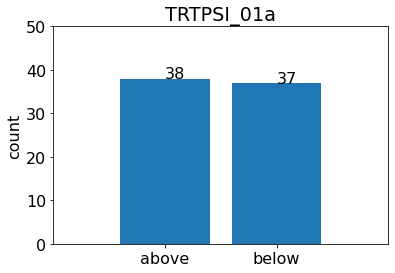

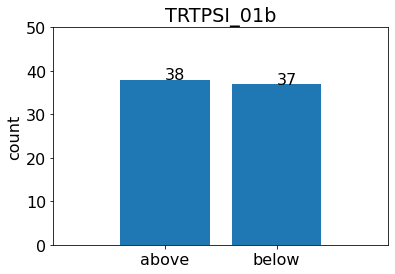

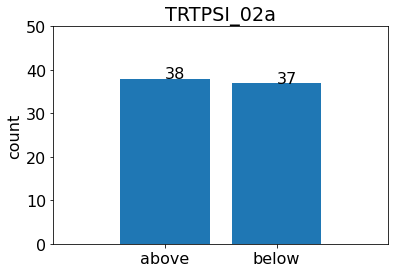

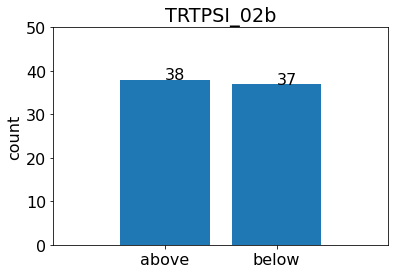

In [17]:
for name, test in grp_tests:
    
    #Calculate the percept of start positions that started above
    started_above = sum(test.AllStarts > test.AllStims)
    started_below = sum(test.AllStarts < test.AllStims)
    
    fig, ax = plt.subplots()
    ax.bar([1, 2], [started_above, started_below])
    ax.text(1,started_above,str(started_above))
    ax.text(2,started_below,str(started_below))
    ax.set(ylim=(0, 50),xlim=(0,3),xticks=[1,2], xticklabels=['above', 'below'],ylabel='count',title=name[0]+name[1])
    plt.show()


## Are the start and end speeds randomized?

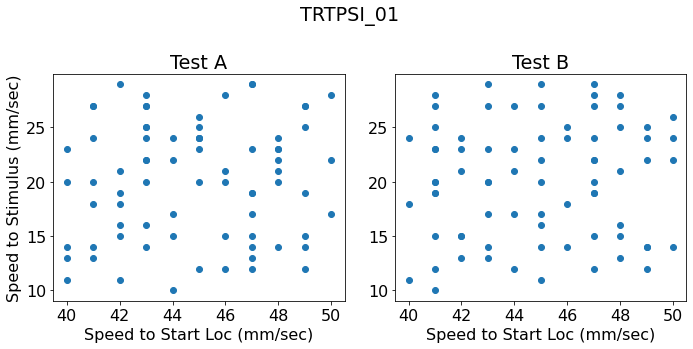

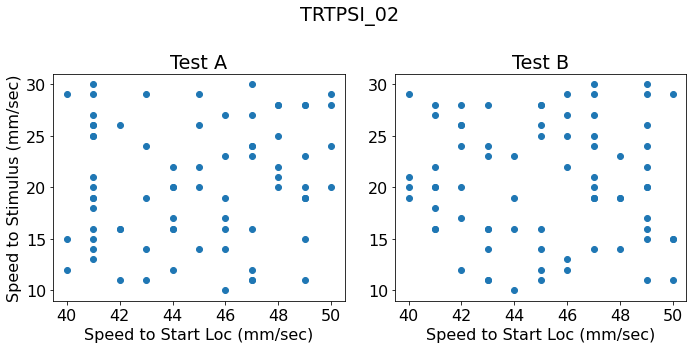

In [18]:
#Loop through all subejcts
for name, test in grp_subjs:
    
    #Index the different tests
    Test_a = test[test.Test=='a']
    Test_b = test[test.Test=='b']
    
    #Plot
    fig, ax = plt.subplots(1,2, figsize=(10,5),tight_layout=True)
    ax[0].plot(Test_a.StartSpeeds, Test_b.StimSpeeds,'o')
    ax[0].set(ylabel='Speed to Stimulus (mm/sec)', xlabel='Speed to Start Loc (mm/sec)', title='Test A')
    ax[1].plot(Test_b.StartSpeeds, Test_b.StimSpeeds,'o')
    ax[1].set(xlabel='Speed to Start Loc (mm/sec)', title='Test B')    
    fig.suptitle(name) 
    plt.show()    

## How much time between the tests, and how long is each test? 

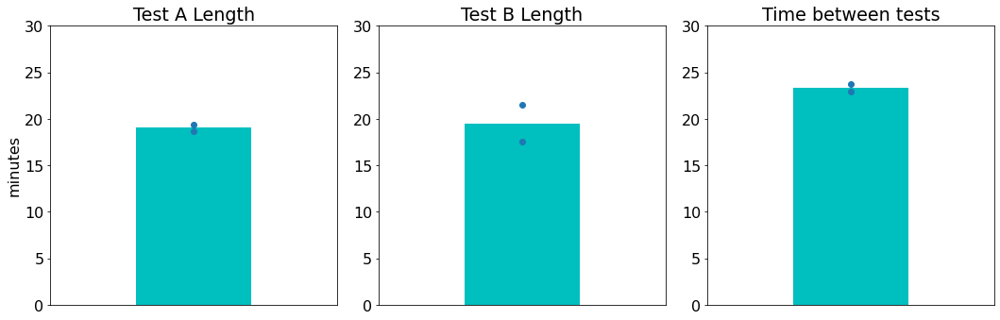

In [19]:
#Loop through all subejcts
all_td, a_len, b_len = [], [], []
for name, test in grp_subjs:
    
    #Index the different tests
    test_a = test[test.Test=='a']
    test_b = test[test.Test=='b']
    
    #calculate the length of each test
    a_len = np.append(a_len, test_a.TestLen[0]/60)
    b_len = np.append(b_len, test_b.TestLen[0]/60)

    #Calculate difference between tests and save
    test_a_end = test_a.StartTime[0] + timedelta(seconds=test_a.TestLen[0])
    time_diff = test_b.StartTime[0] - test_a_end
    all_td = np.append(all_td, time_diff.seconds/60)

#Plot
fig, ax = plt.subplots(1,3,figsize=(15,5),tight_layout=True)
ax[0].bar(0,np.mean(a_len),color='c')
ax[0].plot(np.zeros_like(a_len),a_len,'o')
ax[0].set(xlim=(-1,1), ylim=(0,30), ylabel='minutes', title='Test A Length',xticks=[])

ax[1].bar(0,np.mean(b_len),color='c')
ax[1].plot(np.zeros_like(a_len),b_len,'o')
ax[1].set(xlim=(-1,1), ylim=(0,30), title='Test B Length',xticks=[])

ax[2].bar(0,np.mean(all_td),color='c')
ax[2].plot(np.zeros_like(a_len),all_td,'o')
ax[2].set(xlim=(-1,1), ylim=(0,30), title='Time between tests',xticks=[])
plt.show()

## Are the pre-set simtuli appropriately distributed? 

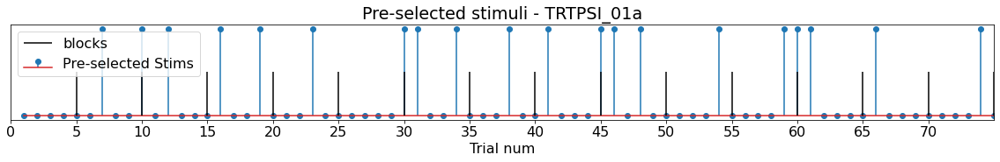

Largest difference between pre-selected stim =  8


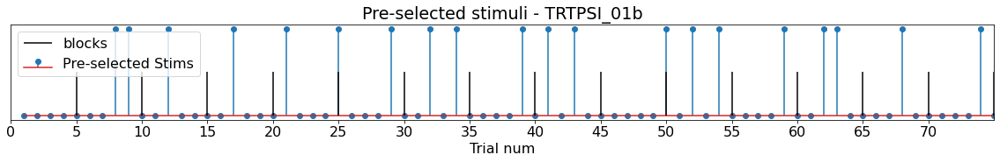

Largest difference between pre-selected stim =  7


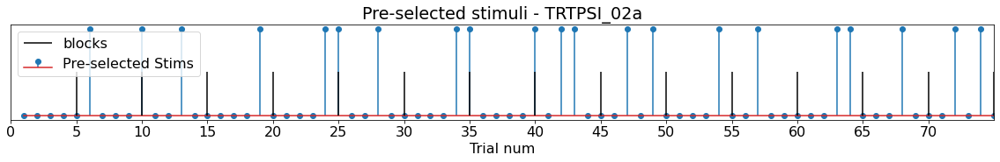

Largest difference between pre-selected stim =  6


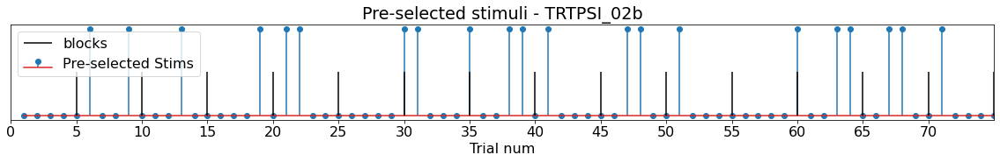

Largest difference between pre-selected stim =  9


In [20]:
blocks = np.arange(5,75,5)
for name, test in grp_tests:
        
    SelectedStims = test.SelectedStims[5:]
    #Plot 
    fig, ax = plt.subplots(figsize=(20,2))
    ax.stem(test.Trial_num,test.SelectedStims, label='Pre-selected Stims')
    ax.vlines(x=[test.Trial_num.values[4::5]],ymin=0,ymax=0.5,color='k', label='blocks')
    ax.set(xlim=(1,75), yticks=[], xticks=np.arange(0,75,5),title='Pre-selected stimuli - '+name[0]+name[1],xlabel='Trial num')
    plt.legend(loc='upper left')
    plt.show()
    
    #Find the max difference between pre-selected stims
    max_diff = np.max(np.diff(test.Trial_num[test.SelectedStims==1]))
    print('Largest difference between pre-selected stim = ', max_diff) 


## Plot start positions

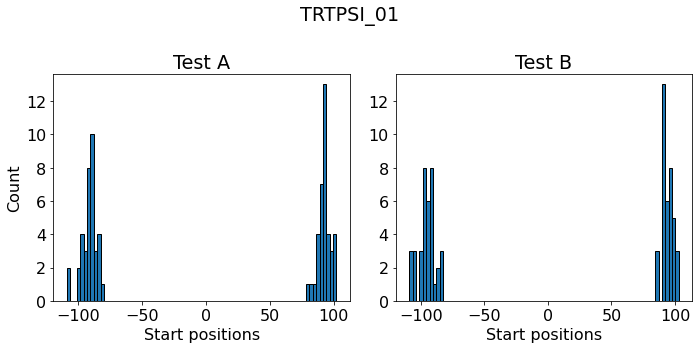

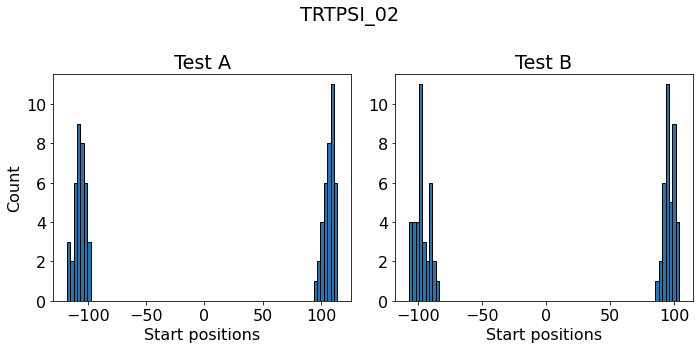

In [29]:
#Loop through all subejcts
for name, test in grp_subjs:
    
    #Index the different tests
    Test_a = test[test.Test=='a']
    Test_b = test[test.Test=='b']
    
    #Plot
    fig, ax = plt.subplots(1,2, figsize=(10,5),tight_layout=True)
    ax[0].hist(Test_a.AllStarts,edgecolor='black',bins=80)
    ax[0].set(ylabel='Count', xlabel='Start positions', title='Test A')
    ax[1].hist(Test_b.AllStarts,edgecolor='black',bins=80)
    ax[1].set(xlabel='Start positions', title='Test B')    
    fig.suptitle(name) 
    plt.show()    

## Post-hoc parameter estimate check

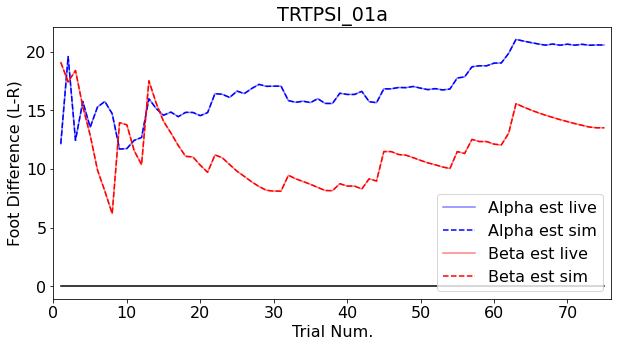

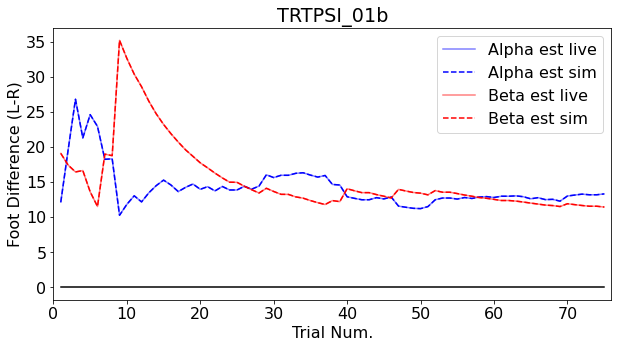

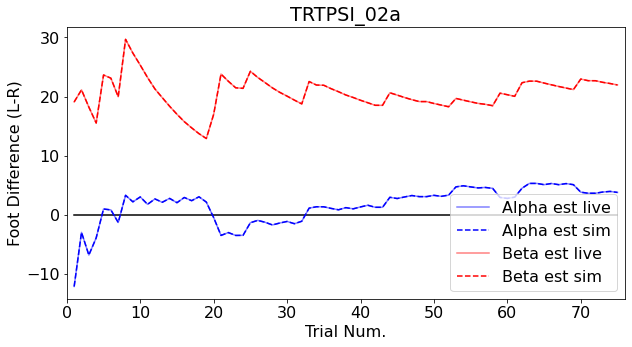

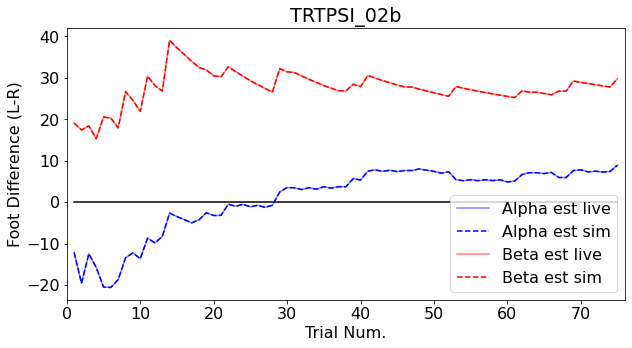

In [30]:
for name, test in grp_tests:
    check_estimates(test)

# Primary Analysis

## Plot test 1 vs test 2

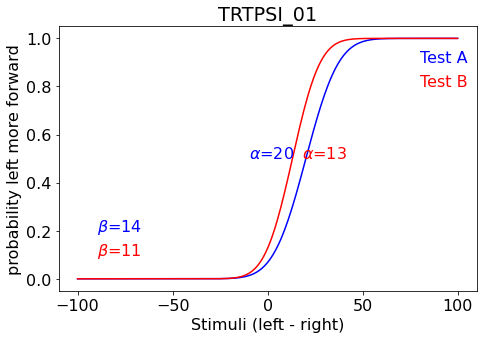

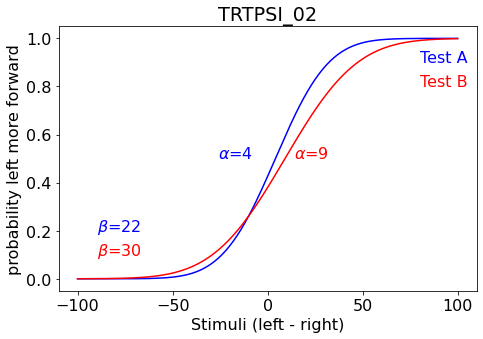

In [70]:
x = np.arange(-100,101)
#Loop through all subejcts
for name, test in grp_subjs:
    
    #Index the different tests
    Test_a = test[test.Test=='a']
    Test_b = test[test.Test=='b']
    
    #Calculate psychometric function for the PSI algorithm
    psi_a = norm.cdf(x,Test_a.Alpha_EV.values[-1]+Test_a.BslDiff.values[0],Test_a.Beta_EV.values[-1])
    psi_b = norm.cdf(x,Test_b.Alpha_EV.values[-1]+Test_b.BslDiff.values[0],Test_b.Beta_EV.values[-1])
    
    #Plot
    fig, ax = plt.subplots(figsize=(7,5),tight_layout=True)
    ax.plot(x, psi_a, 'b')
    ax.text(80,0.9,'Test A', c='b')
    ax.text(Test_a.Alpha_EV.values[-1]+Test_a.BslDiff.values[0]-30, 0.5, r'$\alpha$=' + str(round(Test_a.Alpha_EV.values[-1]+Test_a.BslDiff.values[0])), c='b')
    ax.text(-90, 0.2, r'$\beta$=' + str(round(Test_a.Beta_EV.values[-1])), c='b')
    ax.plot(x, psi_b, 'r', label='Test B')
    ax.text(80,0.8,'Test B', c='r')
    ax.text(Test_b.Alpha_EV.values[-1]+Test_b.BslDiff.values[0]+5, 0.5, r'$\alpha$=' + str(round(Test_b.Alpha_EV.values[-1]+Test_b.BslDiff.values[0])), c='r')
    ax.text(-90, 0.1, r'$\beta$=' + str(round(Test_b.Beta_EV.values[-1])), c='r')    
    ax.set(ylabel='probability left more forward', xlabel='Stimuli (left - right)', title=name)
    plt.show()

## Test A vs Test B

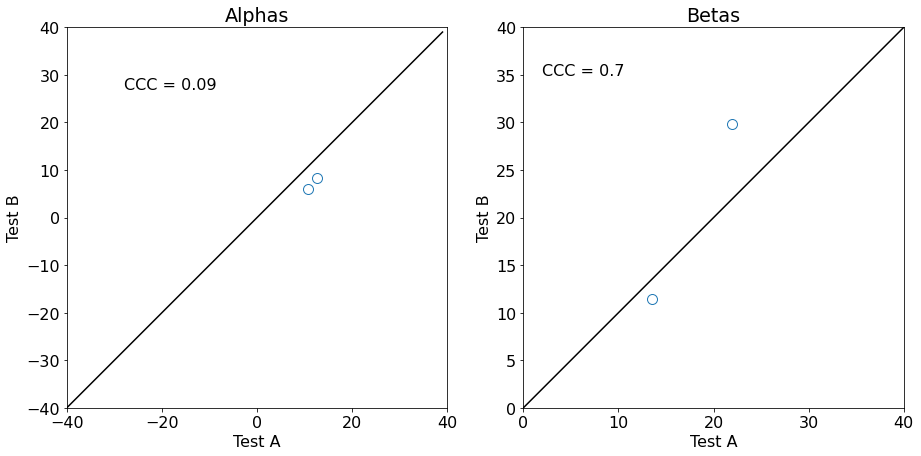

In [33]:
unique_tests = ['a','b']
alphas, betas = np.empty((len(grp_subjs),2)), np.empty((len(grp_subjs),2))
#Extract the final estimates of the alpha and beta values
for subj_name_idx, (name, test) in enumerate(grp_subjs):
    for test_id_idx, test_id in enumerate(unique_tests):
        alphas[subj_name_idx, test_id_idx] = test[test.Test==test_id].Alpha_EV.values[-1]
        betas[subj_name_idx, test_id_idx] = test[test.Test==test_id].Beta_EV.values[-1]
        
alpha_ccc = calc_CCC(alphas[:,0],alphas[:,1])
beta_ccc = calc_CCC(betas[:,0],betas[:,1])

#Plot
fig, ax = plt.subplots(1,2, figsize=(15,7))
ax[0].plot(alphas[:,0], alphas[:,1], 'o', ms=10, mfc='w')
ax[0].plot(np.arange(-40,40), np.arange(-40,40),'k')
ax[0].text(-28, 27, 'CCC = ' + str(round(alpha_ccc,2)))
ax[0].set(xlim=(-40,40), ylim=(-40,40), title='Alphas', xlabel='Test A', ylabel='Test B')
ax[1].plot(betas[:,0], betas[:,1],'o', ms=10, mfc='w')
ax[1].plot(np.arange(0,41), np.arange(0,41),'k')
ax[1].text(2, 35, 'CCC = ' + str(round(beta_ccc,2)))
ax[1].set(xlim=(0,40), ylim=(0,40), title='Betas', xlabel='Test A', ylabel='Test B')
plt.show()

## Bland-Altman plot

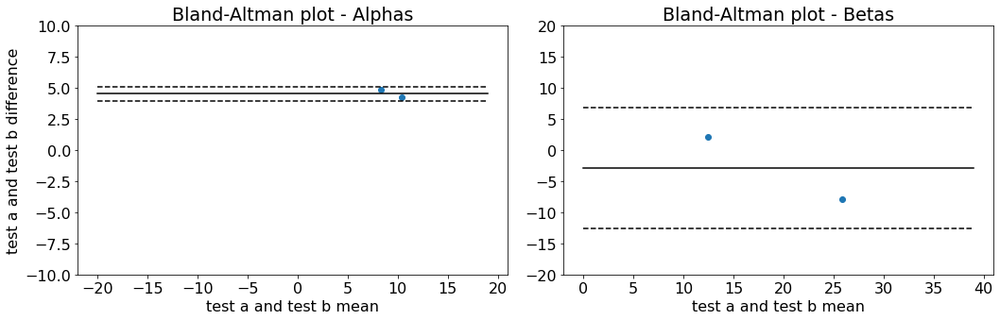

In [72]:
#Calculate the difference between the two scores
alpha_diff = alphas[:,0] - alphas[:,1]
beta_diff = betas[:,0] - betas[:,1]
ci_hi_a, ci_lo_a = CI_95(alpha_diff)
ci_hi_b, ci_lo_b = CI_95(beta_diff)

x_alphas = np.arange(-20,20)
x_betas = np.arange(0,40)

fig, ax = plt.subplots(1,2, figsize=(15,5),tight_layout=True)
ax[0].plot(np.mean(alphas,axis=1), alpha_diff,  'o')
ax[0].plot(x_alphas, np.ones_like(x_alphas)*np.mean(alpha_diff), 'k')
ax[0].plot(x_alphas, np.ones_like(x_alphas)*ci_hi_a, 'k--')
ax[0].plot(x_alphas, np.ones_like(x_alphas)*ci_lo_a, 'k--')
ax[0].set(title='Bland-Altman plot - Alphas', xlabel='test a and test b mean', ylabel='test a and test b difference', ylim=(-10,10))

ax[1].plot(np.mean(betas,axis=1), beta_diff,  'o')
ax[1].plot(x_betas, np.ones_like(x_betas)*np.mean(beta_diff), 'k')
ax[1].plot(x_betas, np.ones_like(x_betas)*ci_hi_b, 'k--')
ax[1].plot(x_betas, np.ones_like(x_betas)*ci_lo_b, 'k--')
ax[1].set(title='Bland-Altman plot - Betas', xlabel='test a and test b mean', ylim=(-20,20))
plt.show()

# Secondary analysis

## Plot the data for each test along with the psi function estimated and fit post-hoc

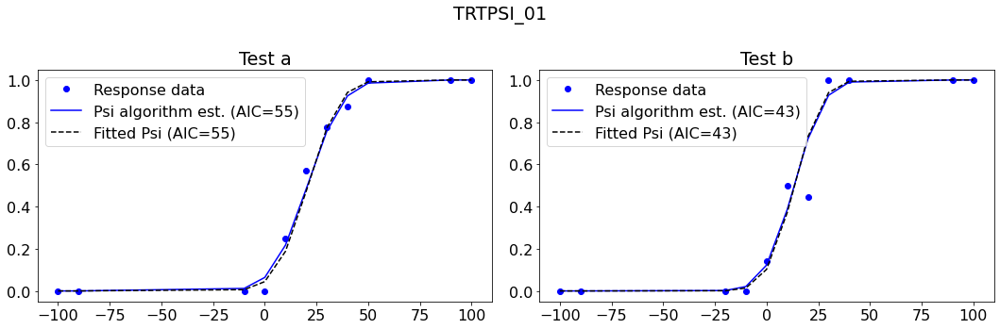

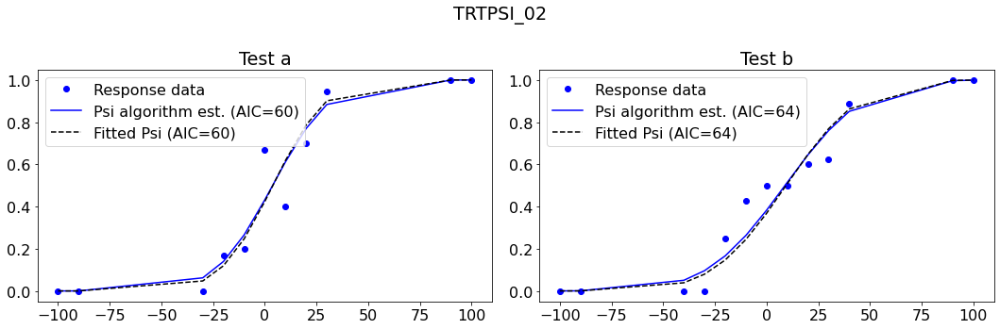

In [42]:
unique_tests = ['a','b']
AIC_diff = []
fit_alphas, fit_betas = np.empty((len(grp_subjs),len(unique_tests))), np.empty((len(grp_subjs),len(unique_tests)))
for subj_name_idx, (name, test) in enumerate(grp_subjs):
    
    fig, ax = plt.subplots(1,2,figsize=(15,5),tight_layout=True)
    for test_id_idx, test_id in enumerate(unique_tests):
        
        #Index the test
        current_test = test[test.Test==test_id]

        #index all the stim positions and baseline correct
        BslDiff = round(current_test.BslDiff.values[0])
        x, Nstims, Kleft = UniqueVals(current_test.AllStims.values+BslDiff, current_test.BinaryResponses.values)

        #Calculate psychometric function for the PSI algorithm
        psi_est = norm.cdf(x,current_test.Alpha_EV.values[-1]+BslDiff,current_test.Beta_EV.values[-1])

        #Use MLE to fit all trials 
        best_params, best_ll = Fit_psi(current_test.AllStims.values+BslDiff, current_test.BinaryResponses.values, 30)

        #Calcualte the function and save the parameters
        psi_fit = norm.cdf(x, best_params[0], best_params[1])
        fit_alphas[subj_name_idx, test_id_idx] = best_params[0]
        fit_betas[subj_name_idx, test_id_idx] = best_params[1]

        #Calculate AIC for both 
        AIC_est = psiAIC([current_test.Alpha_EV.values[-1]+BslDiff,current_test.Beta_EV.values[-1]], [Nstims, Kleft, x])
        AIC_fit = psiAIC(best_params, [Nstims, Kleft, x])
        AIC_diff = np.append(AIC_diff, AIC_fit-AIC_est)

        #Plot
        ax[test_id_idx].plot(x, Kleft/Nstims, 'bo', label='Response data')
        ax[test_id_idx].plot(x, psi_est, 'b', label='Psi algorithm est. (AIC='+  str(round(AIC_est)) +')', alpha=1)
        ax[test_id_idx].plot(x, psi_fit, 'k--', label='Fitted Psi (AIC='+ str(round(AIC_fit)) +')')
        ax[test_id_idx].set(title='Test ' + test_id)
        ax[test_id_idx].legend()
        
    fig.suptitle(name) 
    plt.show()

## How consistent are estimates at different points along the test? 

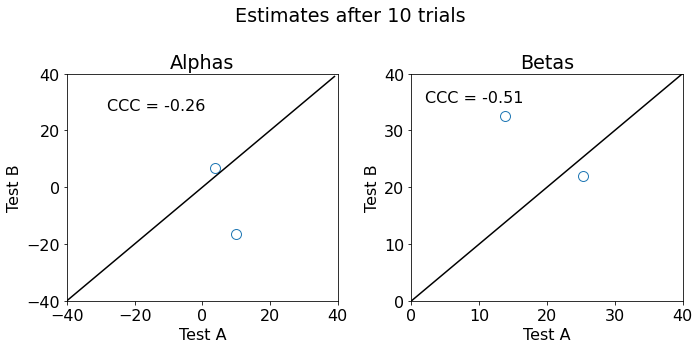

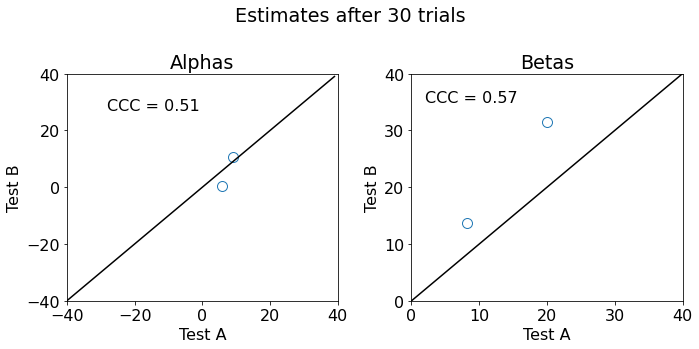

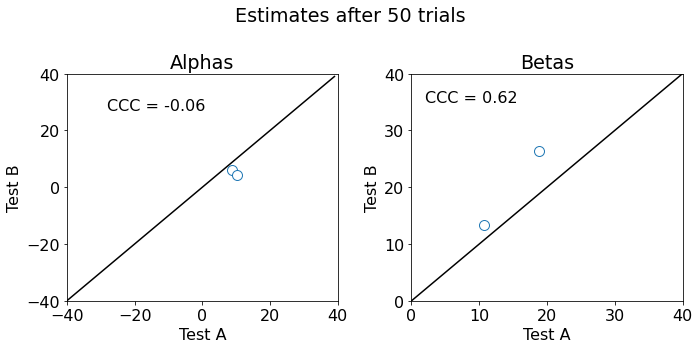

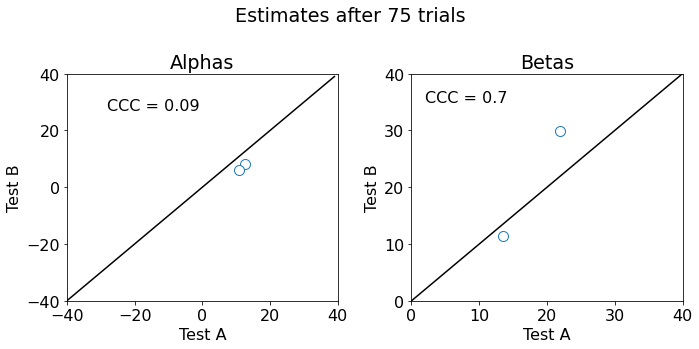

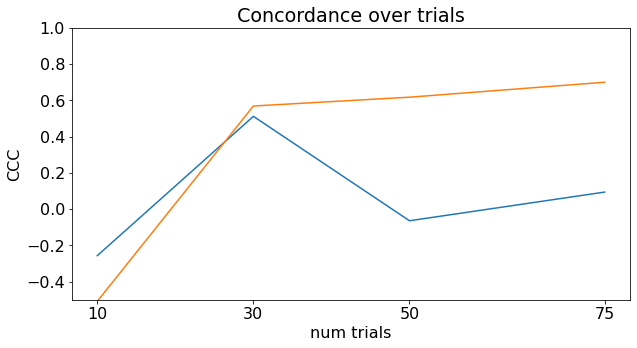

In [42]:
index_estimates = [10, 30, 50, 75]

ccc_alphas, ccc_betas = [], []
for i, num_trls in enumerate(index_estimates):
    alphas, betas = np.empty((len(grp_subjs),2)), np.empty((len(grp_subjs),2))
    #Extract the final estimates of the alpha and beta values
    for subj_name_idx, (name, test) in enumerate(grp_subjs):
        for test_id_idx, test_id in enumerate(unique_tests):
            alphas[subj_name_idx, test_id_idx] = test[test.Test==test_id].Alpha_EV.values[num_trls-1]
            betas[subj_name_idx, test_id_idx] = test[test.Test==test_id].Beta_EV.values[num_trls-1]
            
    ccc_alphas = np.append(ccc_alphas, calc_CCC(alphas[:,0],alphas[:,1]))
    ccc_betas = np.append(ccc_betas, calc_CCC(betas[:,0],betas[:,1]))

    #Plot
    fig, ax = plt.subplots(1,2, figsize=(10,5), tight_layout=True)
    ax[0].plot(alphas[:,0], alphas[:,1], 'o', ms=10, mfc='w')
    ax[0].plot(np.arange(-40,40), np.arange(-40,40),'k')
    ax[0].text(-28, 27, 'CCC = ' + str(round(ccc_alphas[i],2)))
    ax[0].set(xlim=(-40,40), ylim=(-40,40), title='Alphas', xlabel='Test A', ylabel='Test B')
    ax[1].plot(betas[:,0], betas[:,1],'o', ms=10, mfc='w')
    ax[1].plot(np.arange(0,41), np.arange(0,41),'k')
    ax[1].text(2, 35, 'CCC = ' + str(round(ccc_betas[i],2)))
    ax[1].set(xlim=(0,40), ylim=(0,40), title='Betas', xlabel='Test A', ylabel='Test B')
    fig.suptitle('Estimates after ' + str(num_trls) + ' trials')
    plt.show()
    
fig, ax = plt.subplots(figsize=(10,5))
ax.plot(index_estimates, ccc_alphas, label='Alphas')
ax.plot(index_estimates, ccc_betas, label='Betas')
ax.set(title='Concordance over trials', xlabel='num trials', ylabel='CCC', xticks=index_estimates, xticklabels=index_estimates, ylim=(-0.5,1))
plt.show()

## Are decisions different during each 25 trial block? 

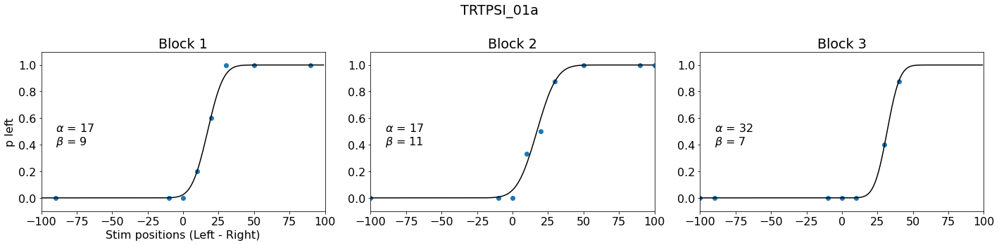

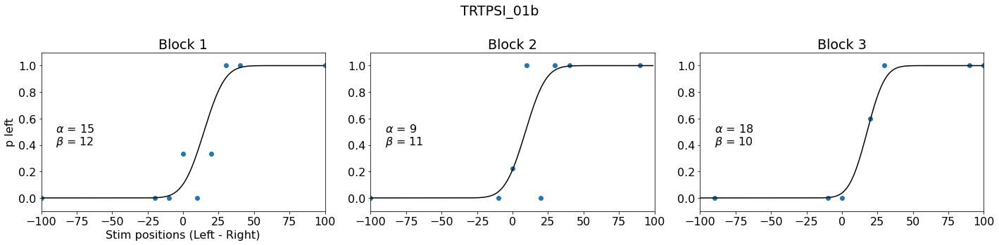

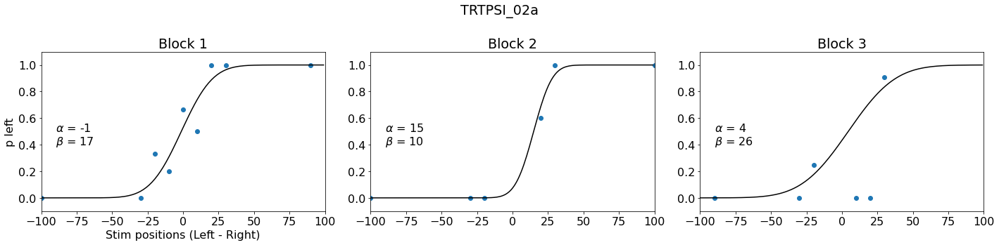

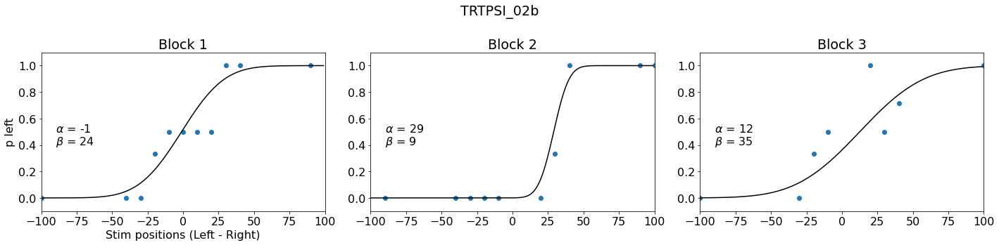

In [43]:
#Set some variables
bouts = np.arange(0,100,25)
unique_tests = ['a','b']
all_alphas, all_betas, idx = np.empty((N*2,3)), np.empty((N*2,3)), 0

for subj_name_idx, (name, test) in enumerate(grp_subjs):
    for test_id_idx, test_id in enumerate(unique_tests):
        
        #Index the test and pertinant data
        current_test = test[test.Test==test_id]
        bsl_diff = round(current_test.BslDiff.values[0])
        stims = current_test.AllStims.values + bsl_diff
        responses = current_test.BinaryResponses.values
        
        test_alphas, test_betas = [], []
        fig, ax = plt.subplots(1,3,figsize=(20,5),tight_layout=True)
        for b in range(len(bouts)-1):
            
            #Index
            bout_stims = stims[bouts[b]:bouts[b+1]]
            bout_resp = responses[bouts[b]:bouts[b+1]]
            
            #Calculate probability of left
            x, Nstims, Kleft = UniqueVals(bout_stims, bout_resp)
            
            #Fit
            best_params, _ = Fit_psi(bout_stims, bout_resp, 30)
            psi_fit = norm.cdf(np.arange(-100,100), best_params[0], best_params[1])
            test_alphas = np.append(test_alphas, best_params[0])
            test_betas = np.append(test_betas, best_params[1])

            #Plot
            ax[b].plot(x, Kleft/Nstims, 'o')
            ax[b].plot(np.arange(-100,100), psi_fit,'k')
            ax[b].text(-90, 0.5, r'$\alpha$ = ' + str(round(best_params[0])))
            ax[b].text(-90, 0.4, r'$\beta$ = ' + str(round(best_params[1])))
            ax[b].set(title='Block ' + str(b+1), xlim=(-100,100), ylim=(-0.1, 1.1))
        
        fig.suptitle(name+test_id)
        ax[0].set(xlabel='Stim positions (Left - Right)', ylabel='p left') 
        plt.show()
        
        all_alphas[idx,:] = test_alphas
        all_betas[idx,:] = test_betas
        idx = idx+1

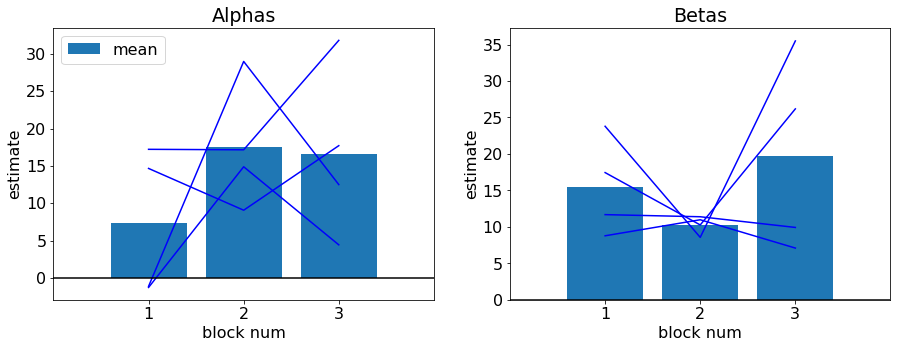

In [44]:
fig, ax = plt.subplots(1,2,figsize=(15,5))
ax[0].bar(np.arange(3),np.mean(all_alphas,axis=0), label='mean')
ax[0].plot(all_alphas.T,'b')
ax[0].plot(np.arange(-1,4), np.zeros(5),'k')
ax[0].set(title='Alphas', xticks=np.arange(3), xticklabels=[1,2,3], xlabel='block num', ylabel='estimate', xlim=(-1,3))
ax[0].legend()
ax[1].bar(np.arange(3),np.mean(all_betas,axis=0))
ax[1].plot(all_betas.T,'b')
ax[1].plot(np.arange(-1,4), np.zeros(5),'k')
ax[1].set(title='Betas', xticks=np.arange(3), xticklabels=[1,2,3], xlabel='block num', ylabel='estimate', xlim=(-1,3))
plt.show()

## Does movement direction impact individuals judgements?
Participants know which direction their leg is moving, this might affect their judgement of final position. 

If this is the case we should organize the data as follows:
* y = responses, the outcome variable where 1 is the judgement that the test limb is more forward
* x_move_dir = coded as 1 (top down) or 0 (bottom up)
* x_stims = coded as a continuous variable 
* x_SID = indexing variable for each subject

**Model:**
$$ L \approx Binomial(1,p) $$
$$ logit(p) = \alpha[x_{SID}] + \beta_{move_dir}[x_{movedir}] + \beta_{stims} * x_{stims}$$
$$ alpha \approx Normal(0,1) $$
$$ \beta_{move_dir} \approx Normal(0,1) $$
$$ \beta_{stims} \approx Normal(0,1) $$

In [108]:
#Set the variables
y = np.array(DF.BinaryResponses,dtype=int) #Binary responses (1=left, 0=right)
x_move_dir = np.array(DF.AllStarts.values > DF.AllStims.values, dtype=int) # 1 for above the stim postiion, 0 for below
x_stims = np.array(DF.AllStims.values, dtype=float) #Stim postiions (continuous)
x_SID = [np.ones(150, dtype=int)*int(i) for i in range(len(np.unique(DF.SID)))]
x_SID = np.concatenate(x_SID)

In [105]:
#Build model using PM 
with pm.Model() as dirmoved_M:
    alpha = pm.Normal("alpha", mu=0, sd=1, shape=N)
    B_movdir = pm.Normal("B_movdir", mu=0, sd=1, shape=2)
    B_stims = pm.Normal("B_stims", mu=0, sd=1)
    p = pm.Deterministic("p", pm.math.invlogit(alpha[x_SID] +
                                               B_movdir[x_move_dir] + 
                                               B_stims * x_stims))
    Lresp = pm.Binomial("Lresp", 1, p, observed=y)
    DM_prior = pm.sample_prior_predictive()
    DM_trace = pm.sample(1000, tune=1000)

Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (4 chains in 4 jobs)
NUTS: [B_stims, B_movdir, alpha]


/Users/jonathanwood/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:624: RuntimeWarning: overflow encountered in _beta_ppf
  return _boost._beta_ppf(q, a, b)
/Users/jonathanwood/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:624: RuntimeWarning: overflow encountered in _beta_ppf
  return _boost._beta_ppf(q, a, b)
/Users/jonathanwood/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:624: RuntimeWarning: overflow encountered in _beta_ppf
  return _boost._beta_ppf(q, a, b)
/Users/jonathanwood/opt/anaconda3/lib/python3.9/site-packages/scipy/stats/_continuous_distns.py:624: RuntimeWarning: overflow encountered in _beta_ppf
  return _boost._beta_ppf(q, a, b)
Sampling 4 chains for 1_000 tune and 1_000 draw iterations (4_000 + 4_000 draws total) took 19 seconds.


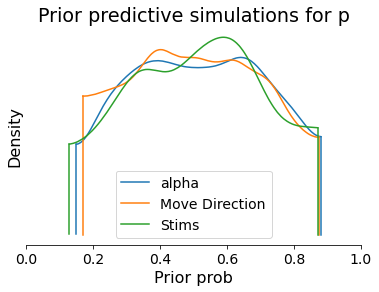

In [109]:
#Check the priors
ax = az.plot_density(
    [logistic(DM_prior["alpha"]), logistic(DM_prior["B_movdir"]), logistic(DM_prior["B_stims"])],
    group="prior",
    data_labels=['alpha', 'Move Direction', 'Stims'],
    point_estimate=None,
    )
plt.xlabel("Prior prob")
plt.ylabel("Density")
plt.title("Prior predictive simulations for p")
plt.xlim(0,1)
plt.show()

Here are the priors in the probability space for each of the beta values. The priors are generally cenetered around 0.5 which is what we would expect without any data. It is impossible to have extremely high or extrememly low probabilities because we dont assume such a large bias for each individual or for the target positions and start positions because they should ben evenly spread around 0.|

Got error No model on context stack. trying to find log_likelihood in translation.
Got error No model on context stack. trying to find log_likelihood in translation.


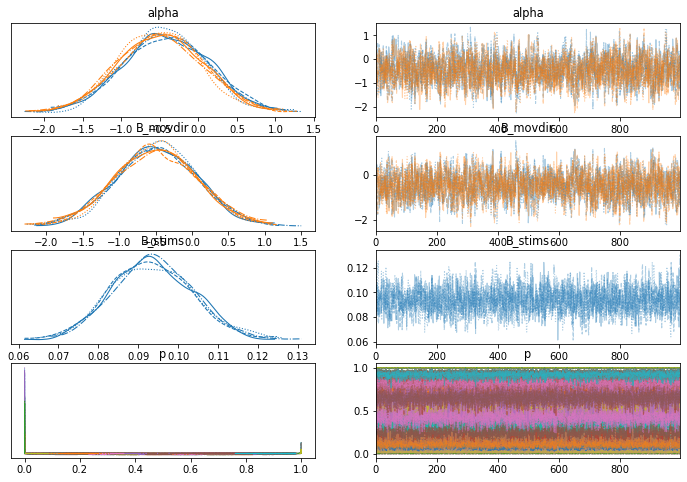

In [110]:
#Check the trace 
az.plot_trace(DM_trace)
plt.show()

Got error No model on context stack. trying to find log_likelihood in translation.


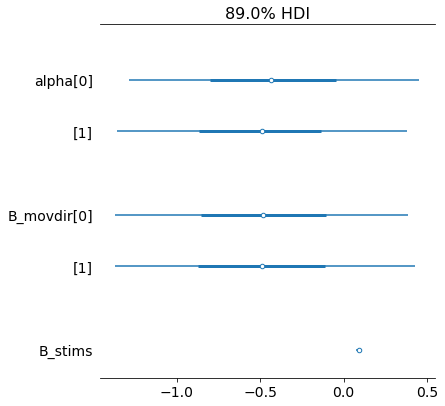

Got error No model on context stack. trying to find log_likelihood in translation.


,mean,sd,hdi_3%,hdi_97%,mcse_mean,mcse_sd,ess_bulk,ess_tail,r_hat
alpha[0],-0.426,0.550,-1.411,0.644,0.017,0.012,1093.0,1572.0,1.0
alpha[1],-0.493,0.547,-1.478,0.570,0.016,0.012,1124.0,1570.0,1.0
B_movdir[0],-0.484,0.552,-1.515,0.557,0.017,0.012,1116.0,1597.0,1.0
B_movdir[1],-0.491,0.563,-1.580,0.545,0.016,0.012,1202.0,1572.0,1.0
B_stims,0.094,0.010,0.075,0.113,0.000,0.000,2019.0,2171.0,1.0


In [111]:
#Summary in log space
az.plot_forest(DM_trace, var_names=["alpha", "B_movdir", "B_stims"], combined=True, hdi_prob=0.89)
plt.show()
az.summary(DM_trace, var_names=["alpha", "B_movdir", "B_stims"])

Here is the model summary for each of the beta values. These values represent the log odds for each individual subject (alpha) and for top down and bottom up movement directions and for the target direction as a whole. 

If the log odds value is 0, what are the odds? We have to exponentiate both sides of this equation: $log(\frac{p}{1-p} = 0)$. Once we do that we get $\frac{p}{1-p} = e^0$. $e^0 = 1$ so an odds of 1 means that it is as likely that the event will happen as it is that the event will not happen. This is because, if $\frac{p}{1-p} = 1$, then $p = 0.5$ So there is no impact of that predictor on the log odds (see the derivation in the intro above, the shorthand is: $p = \frac{x}{1+x}$ This is a sigmoid function! I plotted it below se we can take a look.

The main point in interpreting these beta values:
* Convert to odds by taking the exponent of the value (this makes them interpretable on a relative scale). 
* Convert to probability using this equation  $p = \frac{x}{1+x}$, where x is the odds (the makes them interpratable in probability space, on an absolute scale)

Got error No model on context stack. trying to find log_likelihood in translation.


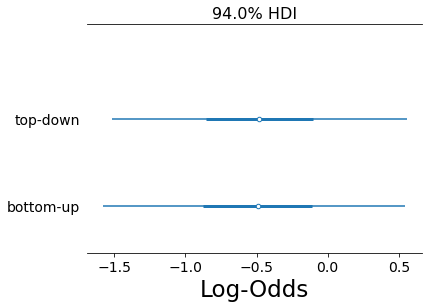

Got error No model on context stack. trying to find log_likelihood in translation.


1.053


In [113]:
#Relative space 
ax = az.plot_forest(DM_trace, var_names=["B_movdir"], combined=True)
ax[0].set_xlabel('Log-Odds',fontsize='x-large')
ax[0].set_yticklabels(['bottom-up','top-down'])
plt.show()
az.summary(DM_trace, var_names=["B_movdir"])

#Top down minus bottom up
Differece = np.exp(DM_trace["B_movdir"][:,1] - DM_trace["B_movdir"][:,0]).mean().round(3)
print(Differece)

On a relative scale (log-odds), moving from the top down vs bottom up does not seem to have a large impact on the final decision. It does seem like when the leg moves from the top down (1) there is a reduced tendencay to say that limb is more forward compared to when the leg is moved from the bottom up. But this difference is not conclusive. 

So top down vs bottom up does not seem to have a large impact. But what about when comparing the movement directoin to the final position?

First, we note that the log odds estimate for final position has much greater certainty compared to the start position. The final position is also outside of the 95% probability interval for the start position.  

Top down multiplies the odds of saying the test limb is more forward by 0.81, a 19% reduction in odds. In other words, they are 19% less likely to say the the test limb is more forward when moving from the top down. 

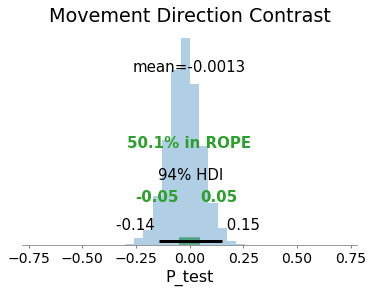

In [114]:
with dirmoved_M:
    DMpost = pm.sample_posterior_predictive(DM_trace, var_names=["B_movdir","B_stims"])
    
az.plot_posterior(logistic(DMpost["B_movdir"][:,1]) - logistic(DM_trace["B_movdir"][:,0]),kind='hist',rope=[-0.05, 0.05])
plt.title('Movement Direction Contrast')
plt.xlabel('P_test')
plt.show()

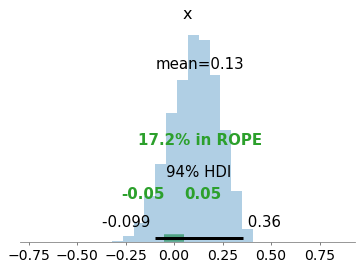

In [115]:
az.plot_posterior(logistic(DMpost["B_stims"]) - logistic(DMpost["B_movdir"])[:,0], 
                  kind='hist', rope=(-0.05, 0.05))
plt.show()

**Interpretation:** When the target limb is moving from the top down, they are more likely than chance to say that the moving limb is more behind. 

When the target limb is moved from the bottom up, individuals are slightly more likely to say that the moving limb is more forward. 

# Trial by trial analysis

## Plot each trial 

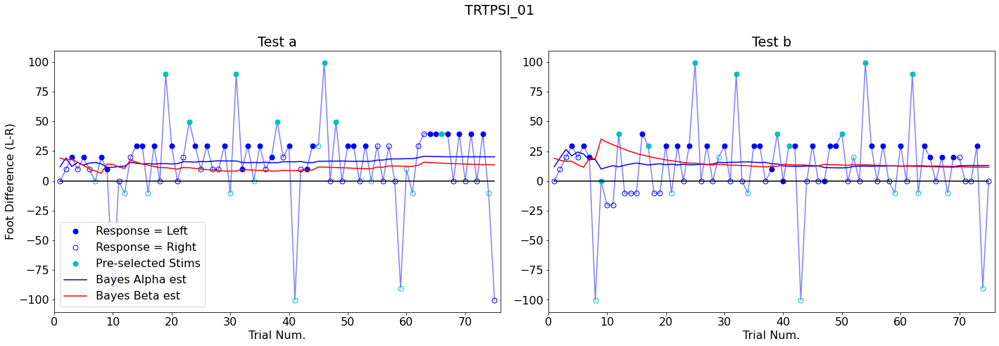

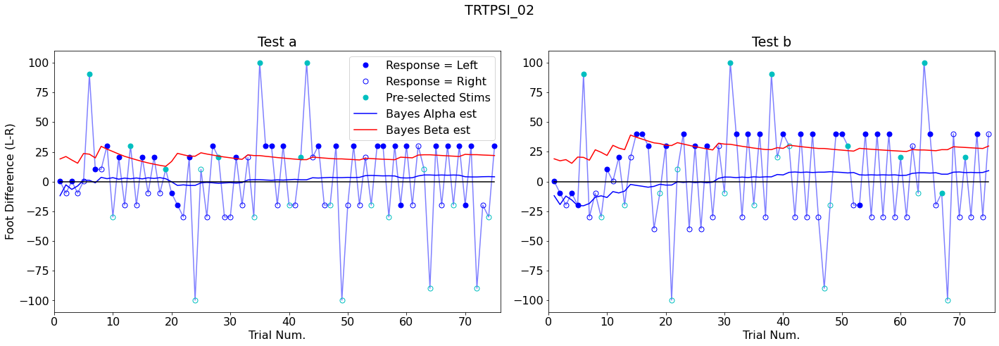

In [48]:
unique_tests = ['a','b']

for name, test in grp_subjs:
    
    fig, ax = plt.subplots(1,2,figsize=(20,7),tight_layout=True)
    for i, test_id_idx in enumerate(unique_tests):
        
        #Index the test
        current_test = test[test.Test==test_id_idx]
        
        #Index stims
        all_stims = current_test.AllStims.values+current_test.BslDiff.values
        alpha_EV = current_test.Alpha_EV.values+current_test.BslDiff.values
        responses = current_test.BinaryResponses.values

        # MLE_alpha, MLE_beta = MLE_each_trial(all_stims,responses)
        
        #Plot            
        ax[i].plot(current_test.Trial_num, all_stims,'b',alpha=0.5)
        ax[i].plot(current_test.Trial_num[(current_test.SelectedStims==0) & (responses==1)], 
                   all_stims[(current_test.SelectedStims==0) & (responses==1)],'bo', markersize=7, label='Response = Left')
        ax[i].plot(current_test.Trial_num[(current_test.SelectedStims==0) & (responses==0)], 
                   all_stims[(current_test.SelectedStims==0) & (responses==0)],'bo',fillstyle='none', markersize=7, label='Response = Right')

        ax[i].plot(current_test.Trial_num[(current_test.SelectedStims==1) & (responses==1)], 
                   all_stims[(current_test.SelectedStims==1) & (responses==1)],'co', markersize=7, label='Pre-selected Stims')
        ax[i].plot(current_test.Trial_num[(current_test.SelectedStims==1) & (responses==0)], 
                   all_stims[(current_test.SelectedStims==1) & (responses==0)],'co',fillstyle='none', markersize=7)
        
        ax[i].plot(current_test.Trial_num,alpha_EV,'b-',label='Bayes Alpha est')
        ax[i].plot(current_test.Trial_num,current_test.Beta_EV,'r-',label='Bayes Beta est')
        # ax[i].plot(current_test.Trial_num,MLE_alpha,'b--',label='MLE Alpha est')
        # ax[i].plot(current_test.Trial_num,MLE_beta,'r--',label='MLE Beta est')
        
        ax[i].plot(current_test.Trial_num,np.zeros(len(current_test)),'k')
        ax[i].set(xlabel='Trial Num.', xlim=(0,len(current_test)+1), title='Test ' + test_id_idx)
        ax[0].set(ylabel='Foot Difference (L-R)')
        ax[0].legend()
                  
    fig.suptitle(name) 
    plt.show()

## Check estimates for each trial

### TRTPSI_01

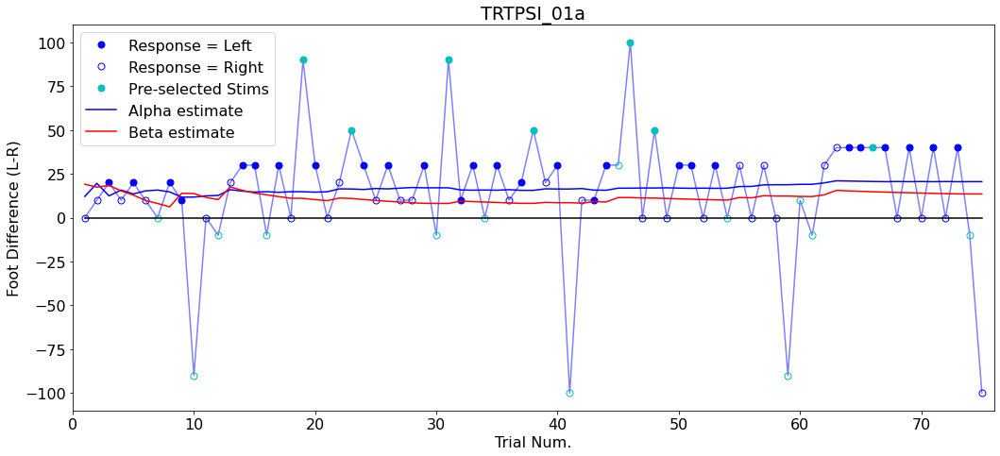

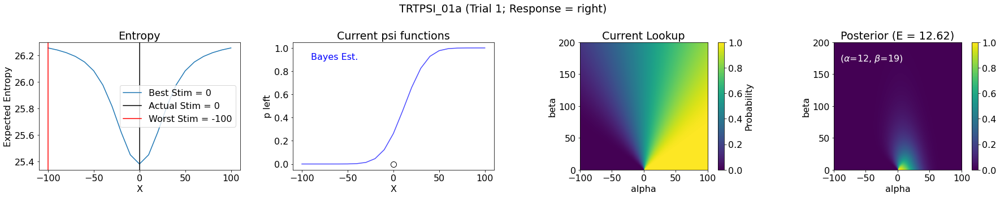

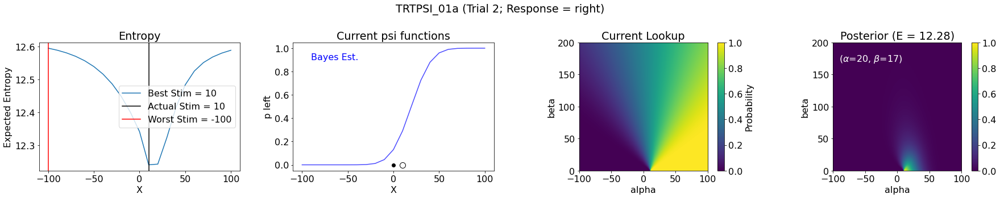

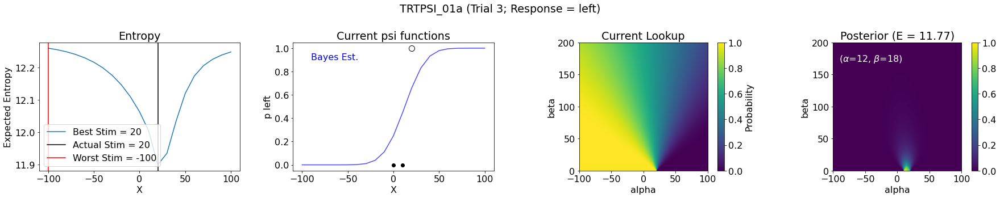

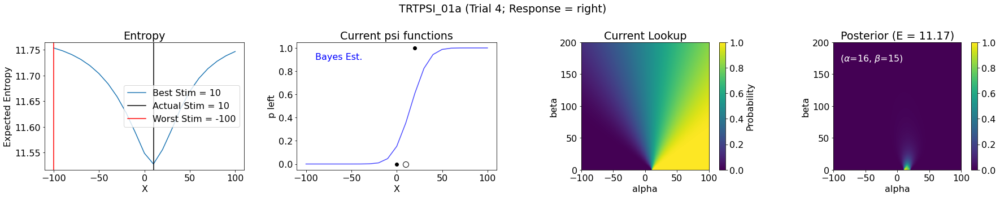

...

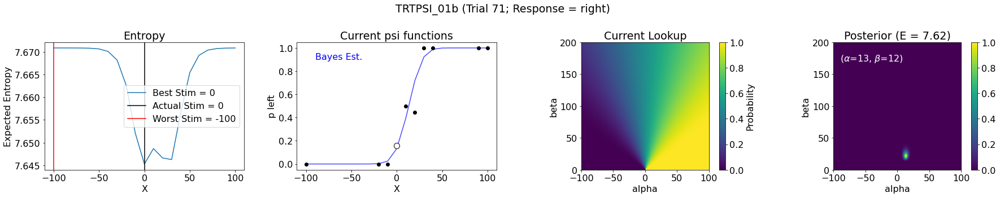

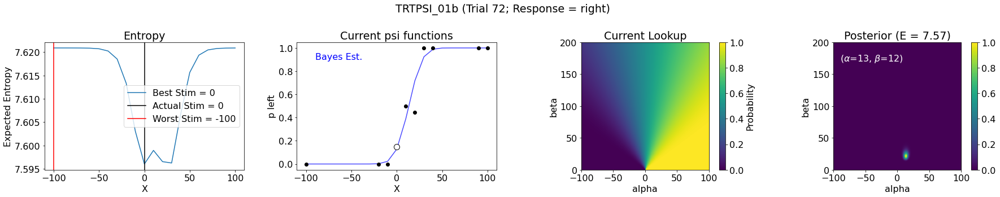

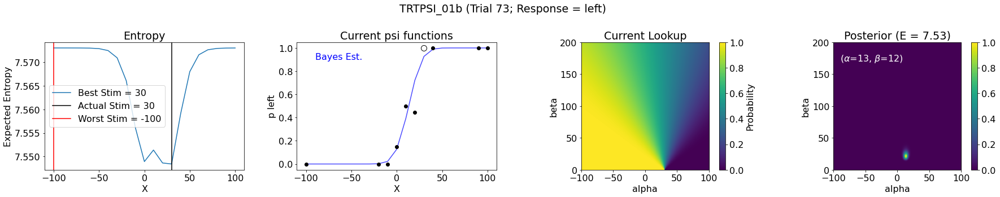

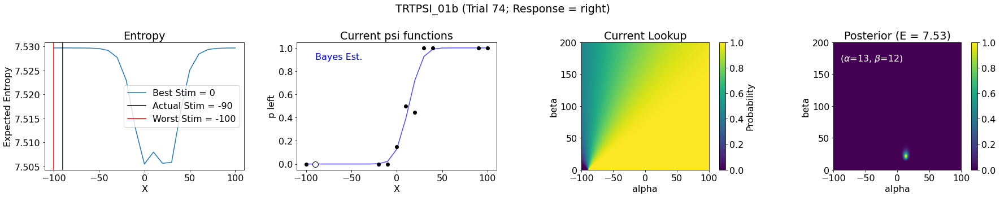

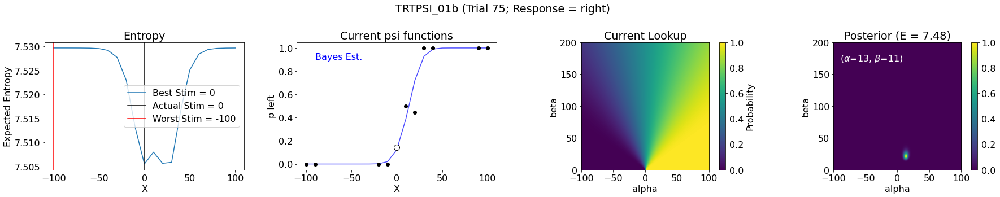

In [80]:
unique_tests = ['a', 'b']
SID = 'TRTPSI_01'
subj_test = DF[DF.SID==SID]
for t in unique_tests:
    
    #Index the different tests
    test = subj_test[subj_test.Test==t]
    check_posterior(test, plt_entropy=False)

### TRTPSI_02

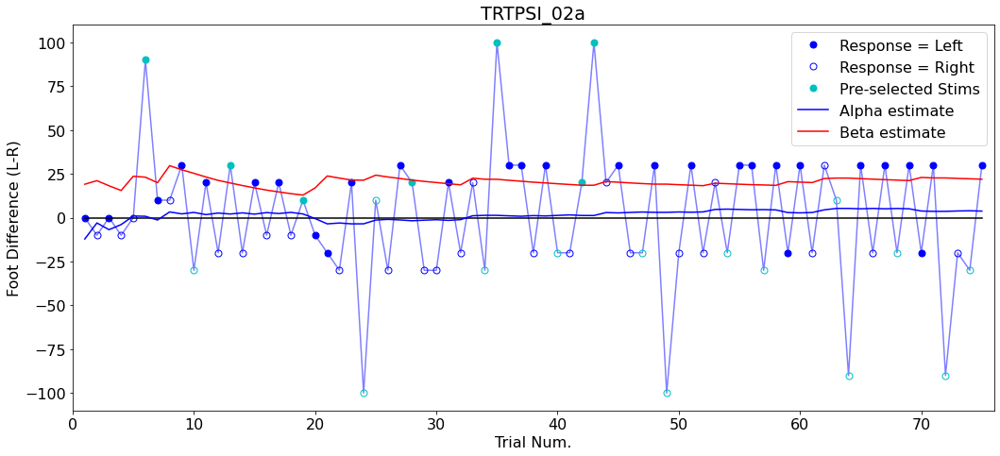

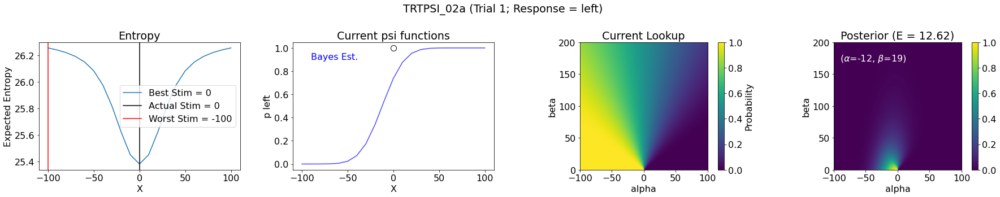

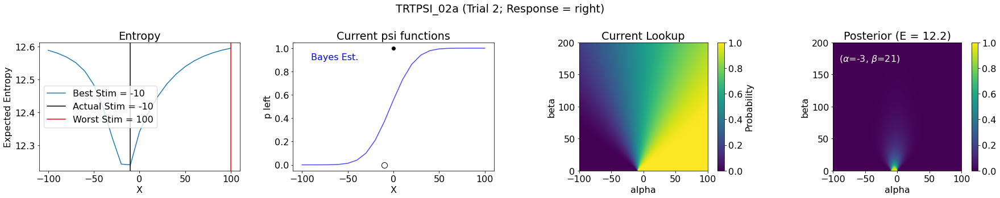

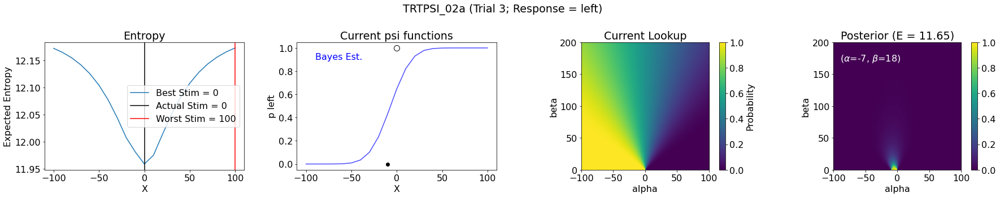

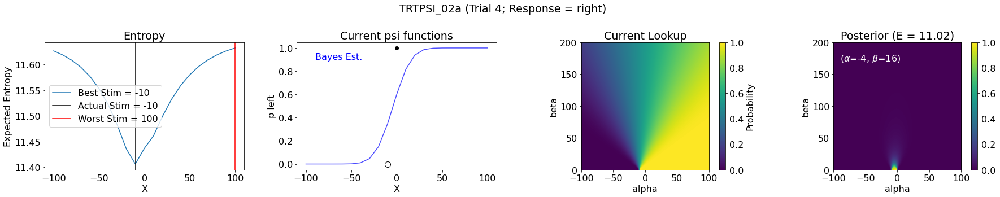

...

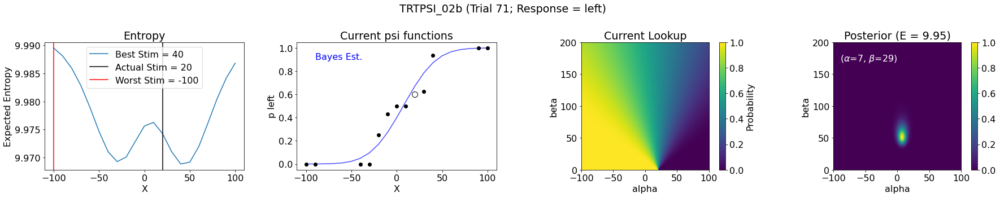

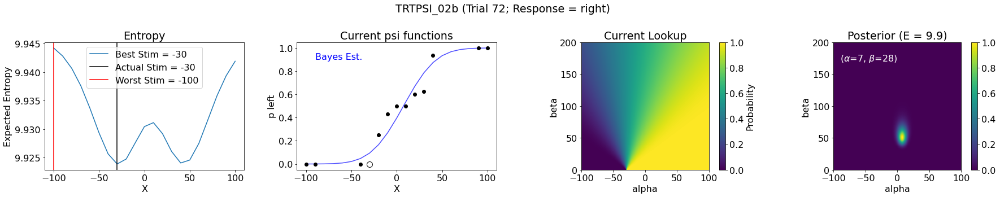

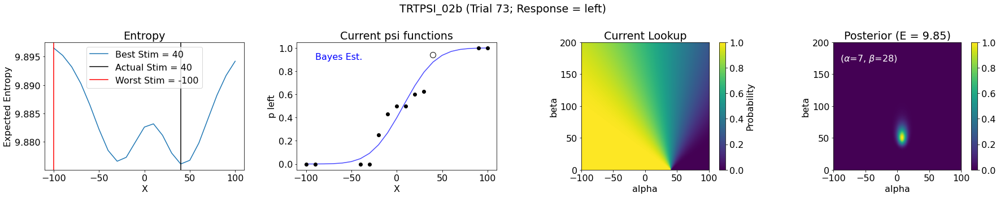

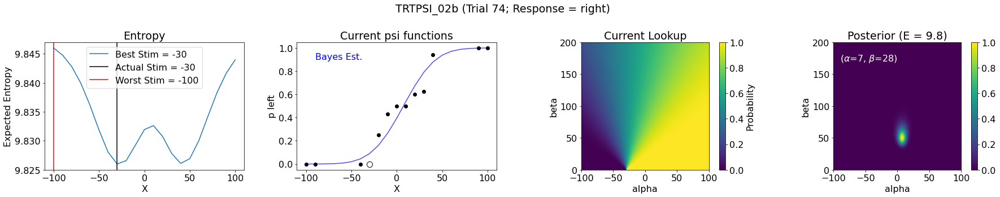

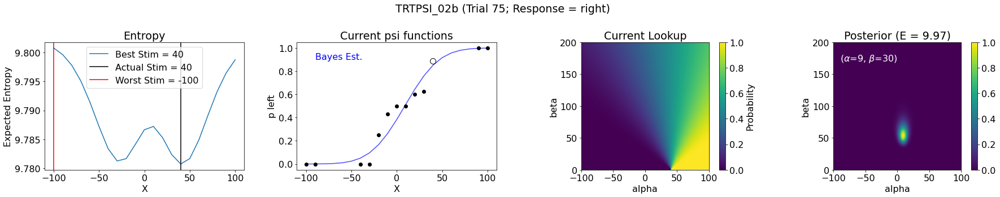

In [81]:
unique_tests = ['a', 'b']
SID = 'TRTPSI_02'
subj_test = DF[DF.SID==SID]
for t in unique_tests:
    
    #Index the different tests
    test = subj_test[subj_test.Test==t]
    check_posterior(test, plt_entropy=False)

### TRTPSI_04

# Simulations

## Simulate an experiment with the parameters and compare results

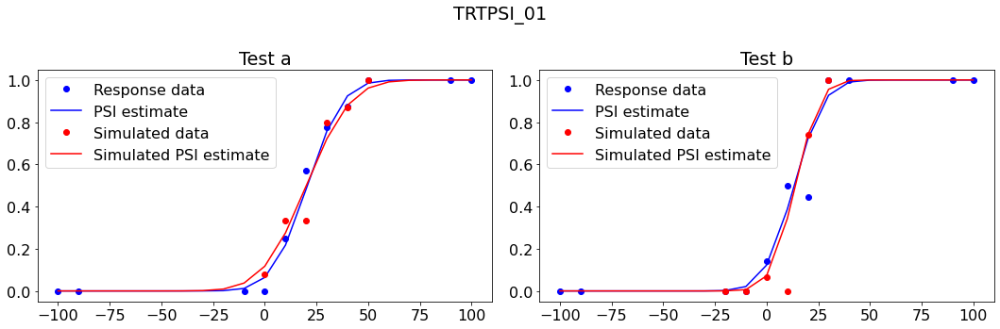

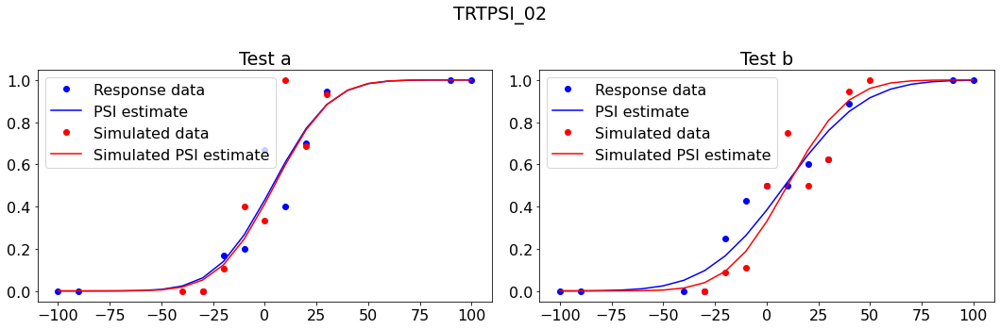

In [19]:
X = np.arange(-100,110,10)
a_range = np.linspace(-100,100,201)
b_range = np.linspace(0.001,100,201)
p_left_look, p_right_look = Psi_lookT(X,a_range,b_range)

#Set the priors
p_alpha = norm.pdf(a_range,0,20)
p_beta = expon.pdf(b_range,0,20)
p_alpha = np.reshape(p_alpha,(1,len(p_alpha)))
p_beta = np.reshape(p_beta,(1,len(p_beta)))
Prior = p_beta.T @ p_alpha

unique_tests = ['a','b']
sim_alphas, sim_betas = [], []
for subj_name_idx, (name, test) in enumerate(grp_subjs):
    fig, ax = plt.subplots(1,2,figsize=(15,5),tight_layout=True)
    for test_id_idx, test_id in enumerate(unique_tests):
        
        #Index the test
        current_test = test[test.Test==test_id]
        BslDiff = round(current_test.BslDiff.values[0])

        #Simualte
        params = [current_test.Alpha_EV.values[-1]+BslDiff, current_test.Beta_EV.values[-1]]
        stims_sim, responses_sim, alpha_EV_sim, beta_EV_sim = sim_psi(params, len(current_test), X, a_range, b_range, p_left_look, p_right_look, Prior)
        sim_alphas.append(alpha_EV_sim[-1])
        sim_betas.append(beta_EV_sim[-1])
        
        #Calculate psychometric function for the simulated PSI algorithm        
        x_sim, Nstims_sim, Kleft_sim = UniqueVals(stims_sim, responses_sim)
        psi_est_sim = norm.cdf(X, alpha_EV_sim[-1], beta_EV_sim[-1])
        
        #Calculate psychometric function for the actual PSI algorithm
        x, Nstims, Kleft = UniqueVals(current_test.AllStims.values+BslDiff, current_test.BinaryResponses.values)
        #Calculate psychometric function for the PSI algorithm
        psi_est = norm.cdf(X,current_test.Alpha_EV.values[-1]+BslDiff,current_test.Beta_EV.values[-1])

        #Plot
        ax[test_id_idx].plot(x, Kleft/Nstims, 'bo', label='Response data')
        ax[test_id_idx].plot(X, psi_est, 'b', label='PSI estimate', alpha=1)
        ax[test_id_idx].plot(x_sim, Kleft_sim/Nstims_sim, 'ro', label='Simulated data')
        ax[test_id_idx].plot(X, psi_est_sim, 'r', label='Simulated PSI estimate')
        ax[test_id_idx].set(title='Test ' + test_id)
        ax[test_id_idx].legend()
    fig.suptitle(name) 
    plt.show()

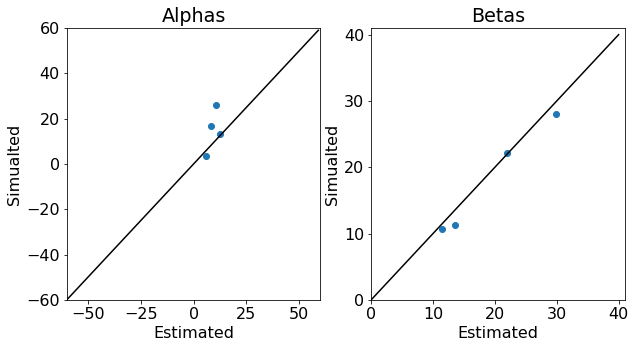

In [51]:
#Compare the simulated and actual estimates
fig, ax = plt.subplots(1,2, figsize=(10,5))
ax[0].plot(np.reshape(alphas,len(alphas)*2), sim_alphas,'o')
ax[0].plot(np.arange(-60,60), np.arange(-60,60),'k')
ax[0].set(xlim=(-60,60), ylim=(-60,60), title='Alphas', xlabel='Estimated', ylabel='Simualted')
ax[1].plot(np.reshape(betas,len(alphas)*2), sim_betas,'o')
ax[1].plot(np.arange(0,41), np.arange(0,41),'k')
ax[1].set(xlim=(0,41), ylim=(0,41), title='Betas', xlabel='Estimated', ylabel='Simualted')
plt.show()